# Lab 4 - Tree-based Learning: Classifiying Particle Physics Data

In this lab, you will learn to:
* Build a decision tree manually
* Build a classifer using random forest with sklearn
* Visualize decision trees
* Build regression model using random forest
* Learn about additional performance metrics and hyper-parameter tuning. 
* Build a classifier for particle physics data

Authors: Tuan Do & Bernie Boscoe

Latest Revision: Tuan Do

In [1]:
# put your imports here
import numpy as np
import pandas as pd
import pylab as plt

# Part A - Building a decision tree by hand

From Question 2 from Chapter 4 of Kelleher 


A convicted criminal who reoffends after release is known as a recidivist. The table below lists a dataset that describes prisoners released on parole, and whether they reoffended within two years of release. This dataset lists six instances where prisoners were granted parole. Each of these instances are described in terms of three binary descriptive features. (GOOD BEHAVIOR, AGE ă 30, DRUG DEPENDENT) and a binary target feature, RECIDIVIST. The GOOD BEHAVIOR feature has a value of true if the prisoner had not committed any infringements during incarceration, the AGE ă 30 has a value of true if the prisoner was under 30 years of age when granted parole, and the DRUG DEPENDENT feature is true if the prisoner had a drug addiction at the time of parole. The target feature, RECIDIVIST, has a true value if the prisoner was arrested within two years of being released; otherwise it has a value of false.


<img src="table.png" alt="drawing" width="600"/>

Note: This example of predicting recidivism is based on a real application of machine learning: parole boards do rely on machine learning prediction models to help them when they are making their decisions. See Berk and Bleich (2013) for a recent comparison of different machine learning models used for this task. Datasets dealing with prisoner recidivism are available online, for exam- ple: catalog.data.gov/dataset/prisoner-recidivism/. The dataset presented here is not based on real data.


### Part A1

### Question 1
(5 pts)

Using this dataset, construct the decision tree that would be generated by the ID3 algorithm, using entropy-based information gain. Show your calculations for information gain and draw your final tree. Hint: follow the example in 4.3.1 in Kelleher. Note, you can upload a separate PDF for this question if you would like to draw or calculate on paper. 

PDF attached separately

### Part A2

### Question 2
(1 pt)

What prediction will the decision tree generated in part 1.1 return for the following query?
GOOD BEHAVIOR = false,AGE < 30 = false, DRUG DEPENDENT = true

The decision tree predicts that the prisoner will be a recidivist.

### Part A3

### Question 3

(1 pt)

What prediction will the decision tree generated in part 1.1 predict for the following query?

GOOD BEHAVIOR = true,AGE > 30 = true, DRUG DEPENDENT = false

The decision tree predicts that the prisoner will be a recidivist.

### Part A4 

### Question 4
(1 pt)

Discuss why this decision tree might lead to biases in inferences about recividism.

Since only a limited number of scenarios are covered in the given table, the tree might be biased towards concluding that prisoners under the age of 30 are likely to be recidivists. There is a possibility that a prisoner under the age of 30 might not be a recidivist but the tree does not take this into its calculatons of information gain and is likely to be biased towards labeling a prisoner under the age of 30 to be a recidivist.

# Part B - Classify irises with a decision tree

Here, we'll repeat the iris classification problem with a decision tree using continuous features. We'll also be using the sklearn decision tree classifier.  


In [2]:
# load the data and the module to visualize decision trees
from sklearn.datasets import load_iris
from sklearn import tree
from sklearn import model_selection

## B1 Building a decision tree with 2 features



## Question 5

(1 pt)

Load the iris data set. Let's start by using only **2 features: sepal length and width**


In [3]:
# enter code here, hint: use your code from your previous labs to load the iris dataset
iris = load_iris()

In [4]:
# Convert to dataframe
iris = pd.DataFrame(data = np.c_[iris['data'], iris['target']], columns= iris['feature_names'] + ['target'])
#print(iris)

sepal_length = iris['sepal length (cm)']
sepal_width = iris['sepal width (cm)']
sepal_features = np.c_[sepal_length, sepal_width]

targets = iris['target'].to_numpy()
# Cast targets to integers to avoid errors later
targets = targets.astype('int64')

**Split the data into training and testing data**

In [5]:
X_train, X_test, y_train, y_test = model_selection.train_test_split(sepal_features, targets, test_size=0.15)

## Question 6
(2 pts)

**Load the classifier**

See the sklearn documentation for more info: https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html

In [6]:
# load the classifier
from sklearn.tree import DecisionTreeClassifier

**Train the classifier**

In [7]:
clf = DecisionTreeClassifier(random_state=0)

In [8]:
clf.fit(X_train,y_train)

DecisionTreeClassifier(random_state=0)

**Visualize your decision tree.** Sklearn has a nice function called tree.plot_tree that will plot the tree you created. 

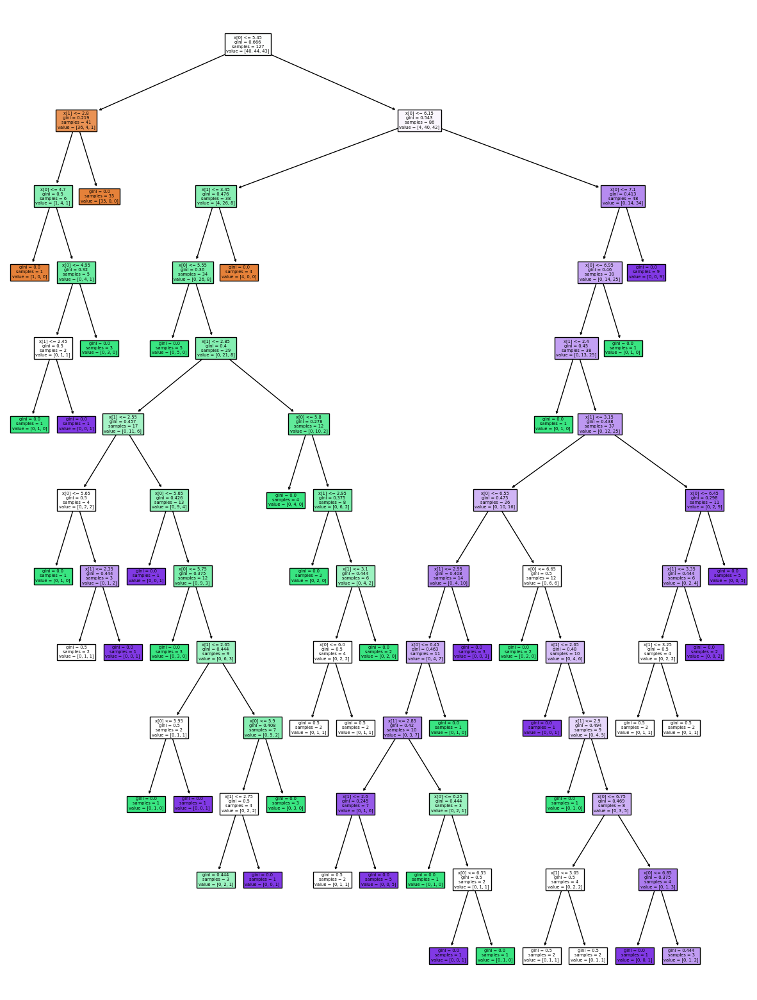

In [9]:
# visualize the tree that was created
plt.figure(figsize=(15,20))
t = tree.plot_tree(clf,filled=True)

## Question 7
(2 pts)

Describe the tree that you created. **Where which feature did the root node use to split? Why? How deep is it? Why is it that deep?**

This is a decision tree used to classify what species an iris is based on its sepal length and sepal width. As seen at the root of the tree, the root node uses the sepal length to do the initial splitting. This decision is made using the Gini criterion where the optimal split is chosen by features with a lower Gini index. The Gini impurity measures the frequency of any element being mislabelled if assigned a random label. As seen in the graph above, the tree has a depth of 13 nodes. The tree keeps splitting until it reaches a Gini index of 0 ur until no further splits can be made since there aren't enough samples left. In this tree, this was achieved after a depth of 13 nodes.

Test the classifier using the **accuracy score**.

In [10]:
# enter your code here
from sklearn.metrics import accuracy_score

y_pred = clf.predict(X_test)
acc_score = accuracy_score(y_test, y_pred)
print("Accuracy score is:", acc_score)

Accuracy score is: 0.782608695652174


**Visualization:** we can visualize how different pairs of iris features would give in terms of their classification in the iris problem. **Run the code cell below to see this decision surface for different pairs of features.** 

/tmp/ipykernel_3516/2801564692.py:38: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(X[idx, 0], X[idx, 1], c=color, label=iris.target_names[i],
/tmp/ipykernel_3516/2801564692.py:38: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(X[idx, 0], X[idx, 1], c=color, label=iris.target_names[i],
/tmp/ipykernel_3516/2801564692.py:38: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(X[idx, 0], X[idx, 1], c=color, label=iris.target_names[i],
/tmp/ipykernel_3516/2801564692.py:38: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(X[idx, 0], X[idx, 1], c=color, label=iris.target_names[i],
/tmp/ipykernel_3516/2801564692.py:38: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(X[idx, 0], X[idx, 1], c=color, label=iris.target_names

(0.0, 7.88, -0.9, 3.4800000000000044)

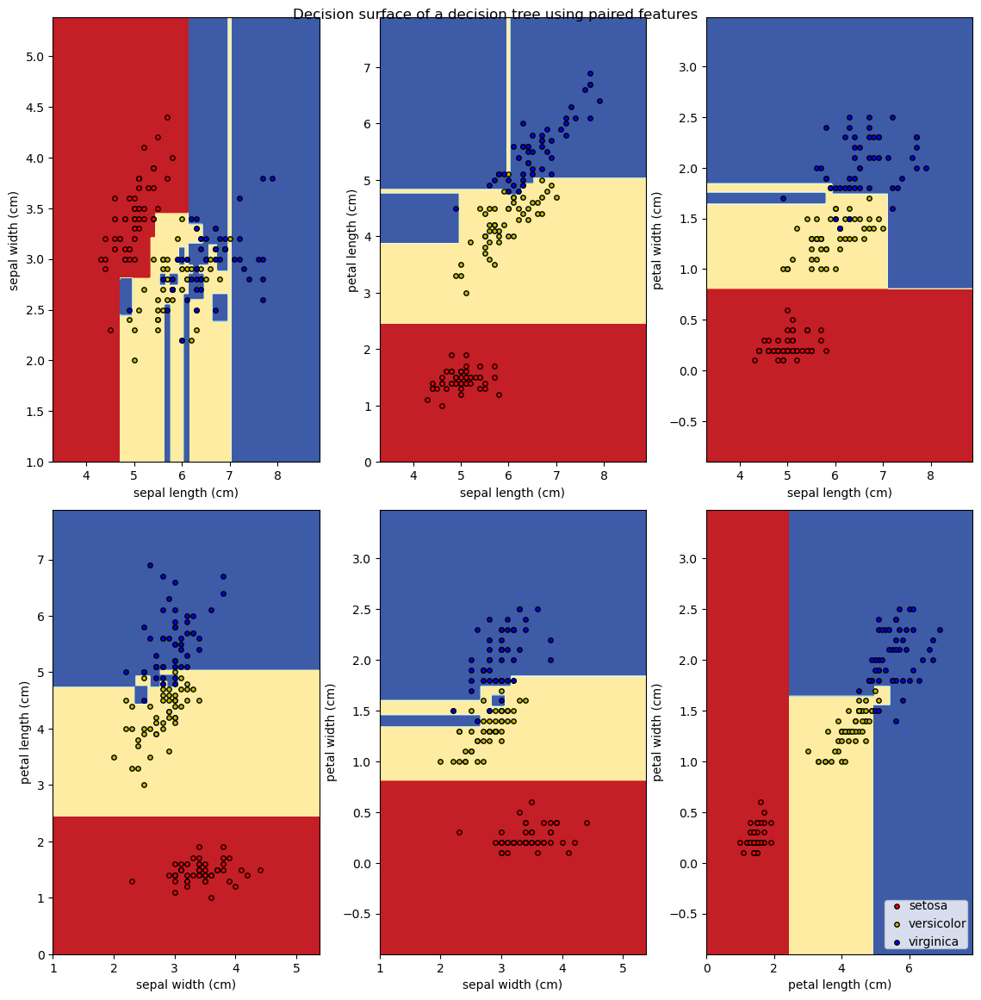

In [11]:
# Parameters
n_classes = 3
plot_colors = "ryb"
plot_step = 0.02

# Load data
iris = load_iris()
plt.figure(figsize=(12,12))

for pairidx, pair in enumerate([[0, 1], [0, 2], [0, 3],
                                [1, 2], [1, 3], [2, 3]]):
    # We only take the two corresponding features
    X = iris.data[:, pair]
    y = iris.target

    # Train
    clf = tree.DecisionTreeClassifier().fit(X, y)

    # Plot the decision boundary
    plt.subplot(2, 3, pairidx + 1)

    x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
    y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, plot_step),
                         np.arange(y_min, y_max, plot_step))
    plt.tight_layout(h_pad=0.5, w_pad=0.5, pad=2.5)

    Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    cs = plt.contourf(xx, yy, Z, cmap=plt.cm.RdYlBu)

    plt.xlabel(iris.feature_names[pair[0]])
    plt.ylabel(iris.feature_names[pair[1]])

    # Plot the training points
    for i, color in zip(range(n_classes), plot_colors):
        idx = np.where(y == i)
        plt.scatter(X[idx, 0], X[idx, 1], c=color, label=iris.target_names[i],
                    cmap=plt.cm.RdYlBu, edgecolor='black', s=15)

plt.suptitle("Decision surface of a decision tree using paired features")
plt.legend(loc='lower right', borderpad=0, handletextpad=0)
plt.axis("tight")

## Question 8
(1 pt)

Based on the plot above, **identify some regions where overfitting is occurring.**

The top 3 regions are clear instances of overfitting. In the upper left, the virginica region is creating splits in the versicolor region and the versicolor region also splits the virginica region while trying to fit around 1 data point. In the upper middle graph, the versicolor region again splits the virginica region trying to fit around a singlr versicolor point. In the upper right graph, the versicolor region incorrectly classifies a virginica point and creates a split in the virginica region, demonstrating overfitting.

## Question 9
(2 pt)

By default, the decision tree can be too deep, which can make it overfit. **Recreate the classifier and use the keyword ``max_depth`` in the ``DecisionTreeClassifier`` object to specify a depth for your tree. Try refitting the data. Does your accuracy score improve?**

Accuracy score is: 0.782608695652174
On average, the accuracy score of the DecisionTreeClassifier improves when using less depth compared to the default depth assigned.


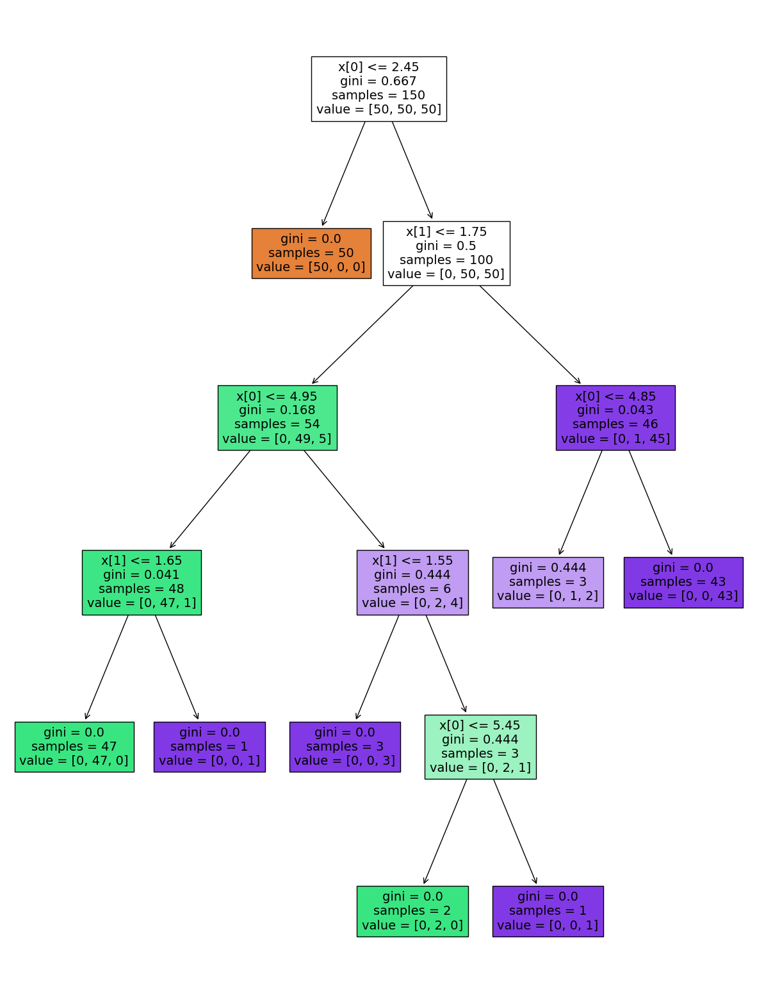

In [12]:
clf_specified_depth = DecisionTreeClassifier(random_state=0, max_depth=5)
clf_specified_depth.fit(X_train,y_train)

# visualize the tree that was created
plt.figure(figsize=(15,20))
t = tree.plot_tree(clf,filled=True)

y_pred = clf_specified_depth.predict(X_test)
acc_score = accuracy_score(y_test, y_pred)

print("Accuracy score is:", acc_score)
print("On average, the accuracy score of the DecisionTreeClassifier improves when using less depth compared to the default depth assigned.")

## B2 Building a decision tree with all features

## Question 10
(4 pts)

Now that you have a sense of how the decision tree works with sklearn, **build a decision tree to classify 
irises using all the features and test it.** 

Accuracy is: 1.0


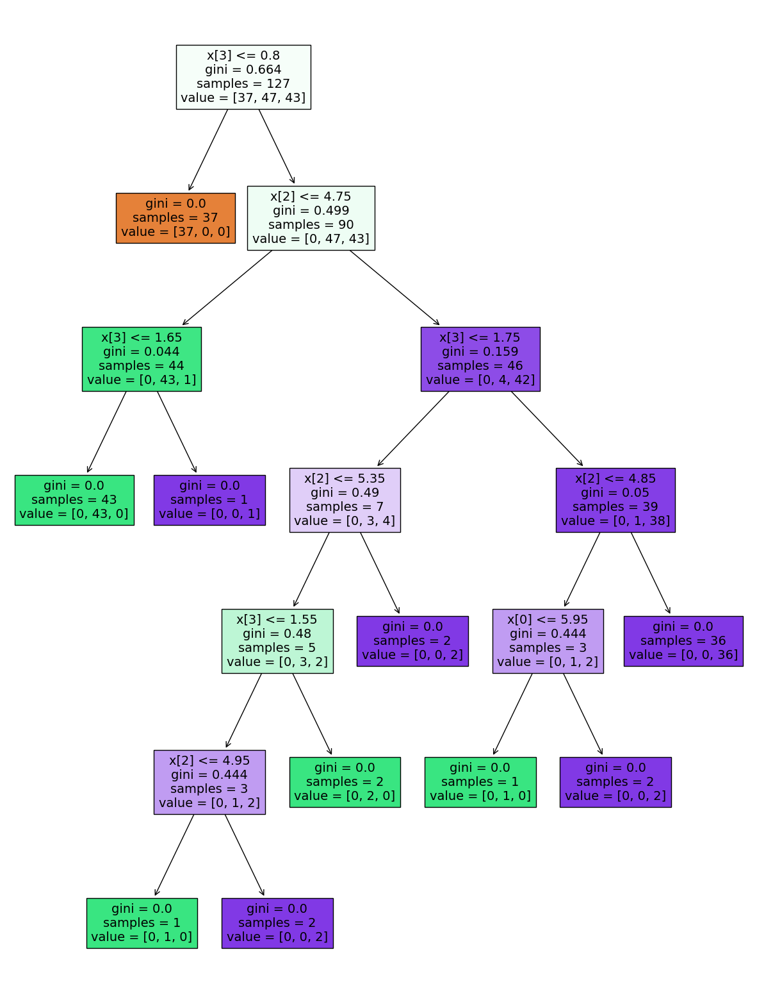

In [13]:
#iris = iris.drop('target')
data = iris['data']

# Split data again with all features
X_train, X_test, y_train, y_test = model_selection.train_test_split(data, targets, test_size=0.15)

clf_iris = DecisionTreeClassifier(random_state=0)
clf_iris.fit(X_train,y_train)

# visualize the tree that was created
plt.figure(figsize=(15,20))
t = tree.plot_tree(clf_iris,filled=True)

y_pred = clf_iris.predict(X_test)

acc_all = accuracy_score(y_test, y_pred)
print("Accuracy is:", acc_all)

## Question 11
(4 pts)

Based on your new tree, answer the following questions:
    
- **What feature does this tree split on? Why?**
- **What is your new accuracy score?**
- **Examine whether your score improves by changing ``max_depth``.** 
- By default, the classifer uses the Gini index to split the nodes. **What happens if you use information entropy instead?**

1. This tree splits on the petal length initially, since this yields a Gini score of 0 in one branch and maximizes the overall information gain.
2. New accuracy score is around 0.91.

In [14]:
# 3. Changing max_depth to 5

clf_iris2 = DecisionTreeClassifier(random_state=0, max_depth=2)
clf_iris2.fit(X_train, y_train)

y_pred2 = clf_iris2.predict(X_test)
acc_all2 = accuracy_score(y_test, y_pred2)
print("Accuracy with max_depth=2 is better than unspecified depth with an accuracy of:", acc_all2)

Accuracy with max_depth=2 is better than unspecified depth with an accuracy of: 0.9130434782608695


In [15]:
# 4. Use information entropy instead of Gini index
clf_iris3 = DecisionTreeClassifier(random_state=0, criterion='entropy')
clf_iris3.fit(X_train, y_train)

y_pred3 = clf_iris3.predict(X_test)
acc_all3 = accuracy_score(y_test, y_pred3)
print("Accuracy when using information gain criteron is:", acc_all3)
print("On average, the information gain criterion yields a slightly higher accuracy than Gini index but is more computationally expensive.")

Accuracy when using information gain criteron is: 1.0
On average, the information gain criterion yields a slightly higher accuracy than Gini index but is more computationally expensive.


# Part C - Classify handwritten digits with random forest

As discussed in lecture and readings, usually we will not make just one decision tree, but rather use an emsemble of them called a random forest. Random forests have many applications and can even be used for image recognition. In this part, we will examine how we could use random forest to classifiy handwritten digits using another classic machine learning dataset. 

This dataset is called MNIST and is used to test many machine learning models (for more information, see http://yann.lecun.com/exdb/mnist/). We'll use our usual framework for an ML workflow for this part.

## C1 Big Picture  

Optical character recognition (OCR) is a very common machine learning task that is used to digitize handwriting. There is a lot of variation in how people write, but the number of possible characters is fairly small, so it is a well defined task. For this part of the lab, we'll try to identify numbers, which means there will be 10 classes (zero to nine). 

## C2 Get the data

In [16]:
from sklearn.datasets import load_digits
digits = load_digits()
digits.keys() # the data is in the form of a dictionary, this will let you see the keys

dict_keys(['data', 'target', 'frame', 'feature_names', 'target_names', 'images', 'DESCR'])

## C3 Explore the data


## Question 12
(2 pts)

Check the shape, and head, plot, visualize, and have a look at the data with whatever ways you think will help your task. Comment throughout on observations. There is some code below to look at some sample of digits

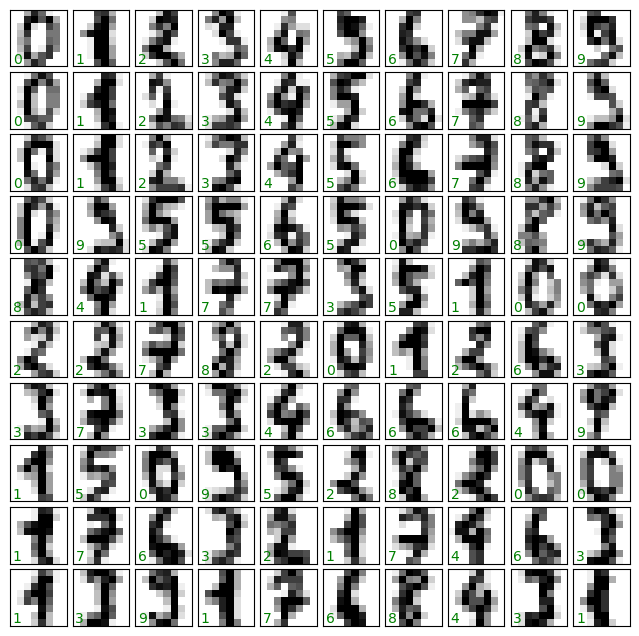

In [17]:
# We can display some of the digits to see what they look like
fig, axes = plt.subplots(10, 10, figsize=(8, 8),
                         subplot_kw={'xticks':[], 'yticks':[]},
                         gridspec_kw=dict(hspace=0.1, wspace=0.1))

for i, ax in enumerate(axes.flat):
    ax.imshow(digits.images[i], cmap='binary', interpolation='nearest')
    ax.text(0.05, 0.05, str(digits.target[i]),
            transform=ax.transAxes, color='green')

In [18]:
# Check shape of data
hand_digits = pd.DataFrame(data = np.c_[digits['data'], digits['target']], columns= digits['feature_names'] + ['target'])
print(hand_digits.shape)

(1797, 65)


In [19]:
# Check head
hand_digits.head()

,pixel_0_0,pixel_0_1,pixel_0_2,pixel_0_3,pixel_0_4,pixel_0_5,pixel_0_6,pixel_0_7,pixel_1_0,pixel_1_1,...,pixel_6_7,pixel_7_0,pixel_7_1,pixel_7_2,pixel_7_3,pixel_7_4,pixel_7_5,pixel_7_6,pixel_7_7,target
0,0.0,0.0,5.0,13.0,9.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,6.0,13.0,10.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,12.0,13.0,5.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,11.0,16.0,10.0,0.0,0.0,1.0
2,0.0,0.0,0.0,4.0,15.0,12.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,3.0,11.0,16.0,9.0,0.0,2.0
3,0.0,0.0,7.0,15.0,13.0,1.0,0.0,0.0,0.0,8.0,...,0.0,0.0,0.0,7.0,13.0,13.0,9.0,0.0,0.0,3.0
4,0.0,0.0,0.0,1.0,11.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,2.0,16.0,4.0,0.0,0.0,4.0


In [20]:
# Visualize data in meaningful manner
hand_digits.corr()

,pixel_0_0,pixel_0_1,pixel_0_2,pixel_0_3,pixel_0_4,pixel_0_5,pixel_0_6,pixel_0_7,pixel_1_0,pixel_1_1,...,pixel_6_7,pixel_7_0,pixel_7_1,pixel_7_2,pixel_7_3,pixel_7_4,pixel_7_5,pixel_7_6,pixel_7_7,target
pixel_0_0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
pixel_0_1,NaN,1.000000,0.556618,0.207814,-0.018761,0.060776,0.048388,-0.038927,0.032320,0.556372,...,-0.045342,-0.007905,0.855610,0.555727,0.147646,-0.102349,-0.029870,0.026547,-0.043889,-0.051834
pixel_0_2,NaN,0.556618,1.000000,0.560180,-0.084235,0.043569,0.002841,-0.062278,0.022311,0.582259,...,-0.003804,-0.025837,0.515276,0.937623,0.499840,-0.134754,-0.041183,0.072599,0.082523,-0.011836
pixel_0_3,NaN,0.207814,0.560180,1.000000,0.023938,-0.171377,-0.115732,-0.040139,0.035663,0.328344,...,0.075335,-0.049085,0.175804,0.560326,0.767945,-0.065957,-0.054936,0.053437,0.081971,-0.011489
pixel_0_4,NaN,-0.018761,-0.084235,0.023938,1.000000,0.507731,0.127764,0.010065,0.042065,0.051657,...,-0.212220,0.017352,-0.047223,-0.020176,-0.008867,-0.082125,-0.215809,-0.250699,-0.215349,0.100801
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
pixel_7_4,NaN,-0.102349,-0.134754,-0.065957,-0.082125,-0.351146,-0.383522,-0.178243,0.048996,-0.000604,...,0.105101,0.005697,-0.117908,-0.207957,0.058390,1.000000,0.609515,0.243305,0.103015,-0.196083
pixel_7_5,NaN,-0.029870,-0.041183,-0.054936,-0.215809,-0.268818,-0.304111,-0.141174,0.033409,0.071488,...,0.262795,-0.003056,-0.043889,-0.091839,-0.094956,0.609515,1.000000,0.648328,0.261991,-0.079100
pixel_7_6,NaN,0.026547,0.072599,0.053437,-0.250699,-0.267659,-0.178945,-0.063220,0.020689,0.111569,...,0.511726,-0.011932,0.014557,0.035369,0.006849,0.243305,0.648328,1.000000,0.620428,-0.114007
pixel_7_7,NaN,-0.043889,0.082523,0.081971,-0.215349,-0.167727,-0.080309,-0.024505,-0.005226,-0.001404,...,0.563989,-0.004625,-0.047089,0.031193,0.099671,0.103015,0.261991,0.620428,1.000000,-0.181929


<Axes: >

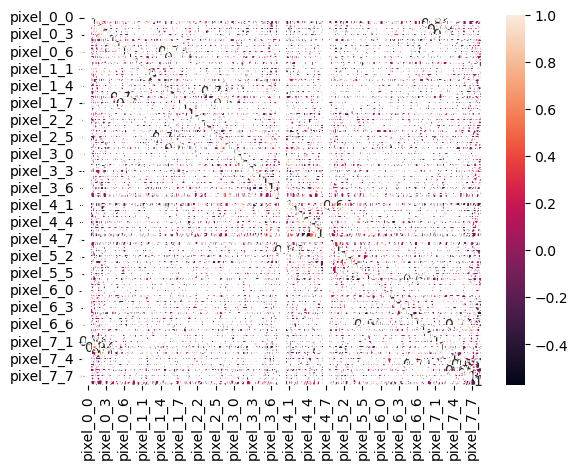

In [21]:
# Visualize data in a way that will be helpful
import seaborn as sns

sns.heatmap(hand_digits.corr(), annot=True)

## C4 Prepare Data

For this assignment, the data is already prepared and is part of the digits dictionary. No need to do anything else for this part.

## C5 Select model and train


## Question 12
(6 pts)

Here, we'll be using the pixels as features and the digit as the target. We will use the random forest classifier from sklearn to model the data. 

Remember, in this part, you'll need to :

- Split the data into training, validation, and testing
- Build a random forest classifier 
- Train the classifier 


In [22]:
from sklearn.ensemble import RandomForestClassifier

In [23]:
features = digits['data']
targets = digits['target']

# Split data into training, validation, and testing
X_train_all, X_validate, y_train_all, y_validate = model_selection.train_test_split(features, targets, test_size=0.1)

# Split the training data further into training and testing
X_train, X_test, y_train, y_test = model_selection.train_test_split(X_train_all, y_train_all, test_size=0.2)

# Build random forest classifier
clf_digits = RandomForestClassifier(random_state=0)

# Train classifier
clf_digits.fit(X_train, y_train)

RandomForestClassifier(random_state=0)

### Performance / evaluation metrics

## Question 13
(6 pts)

We have mainly been using **accuracy score** as a metric for classification, but that is just one measure of how well our predictions are. For this part, let's compute some additional metrics.

- First, compute the accuracy score of your random forest classifier. 
- Compute the confusion matrix and plot it (see lab 1)
- Learn about and compute another classification metric in sklearn: https://scikit-learn.org/stable/modules/model_evaluation.html#classification-metrics

In [24]:
# Compute accuracy score of random forest classifier
y_pred = clf_digits.predict(X_test)
acc = accuracy_score(y_test, y_pred)
print("Accuracy of random forest classifier is:", acc)

Accuracy of random forest classifier is: 0.9660493827160493


[[23  0  0  0  1  0  0  0  0  0]
 [ 0 42  0  0  0  0  0  0  0  0]
 [ 1  0 32  0  0  0  0  0  0  0]
 [ 1  1  0 33  0  0  0  0  1  0]
 [ 0  0  0  0 28  0  0  0  0  0]
 [ 0  0  0  0  0 36  1  0  0  0]
 [ 0  0  0  0  0  0 22  0  0  0]
 [ 0  0  0  0  0  0  0 32  0  0]
 [ 0  2  0  1  0  0  0  0 36  0]
 [ 0  0  0  0  0  0  0  1  1 29]]


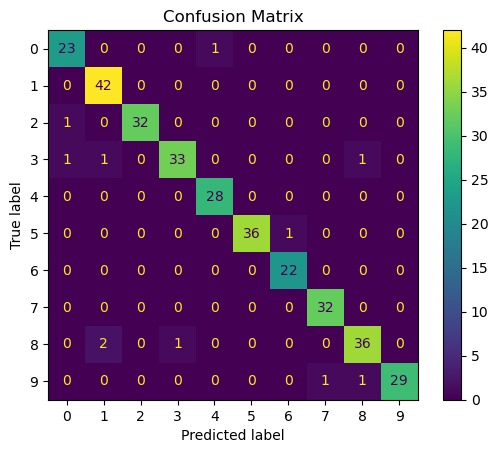

In [25]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Compute confusion matrix and plot it
cm = confusion_matrix(y_test, y_pred)
print(cm)

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=clf_digits.classes_)
disp.plot()
plt.title('Confusion Matrix')
plt.show()

In [26]:
from sklearn.metrics import recall_score

# Another one (classification metric)
# Chose the recall score which gives the ability of the classifier to find all positive samples
# Values range between 0 and 1 with 0 being the worst and 1 being the best
recall_metric = recall_score(y_test, y_pred, average='macro')
print("The recall score is:", recall_metric)

The recall score is: 0.9676230736714608


## 3.6 Fine tune model


## Question 14
(6 pts)

The random forest classifier has many hyper-parameters to tune that can make your classification better. Here, you'll conduct some systematic experiments in tuning hyper-parameters to see how they affect the model performance. 

- First, read the documentation for the random forest classifier to see the different hyper-parameters https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html
- Pick one of the hyper-parameters to tune (some examples are: ``n_estimators``, ``max_depth``, ``min_samples_leaf``, ``max_leaf_nodes``)
- Systematically vary one of these hyper-parameters and record your performance metric (for example accuracy score). Plot this relationship. 
- If you want to search multiple parameters in a grid, sklearn also has a wrapper function that is very useful called ``GridSearchCV`` https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html
- Discuss the results of your experiments

In [27]:
# The hyper-parameter I will vary is n_estimators
# So far, we have changed max_depth but I am curious to test the fundamental idea behind an ensemble model which states that accuracy will increase as number of predictions from differen models increase

# Number of trees will be 10, 20, 30,..., 150
total_trees = np.arange(10,260,10)

# Store accuracy scores
accuracies = []

# Separate function for classifier to make more readable code
def randForClf(X_train_data, X_test_data, y_train_data, y_test_data, num_trees):
    # Build random forest classifier
    clf = RandomForestClassifier(n_estimators=10*num_trees, random_state=0)

    # Train classifier
    clf.fit(X_train_data, y_train_data)

    # Make predictions
    y_pred = clf.predict(X_test_data)

    # Compute and return accuracy score
    accuracy = accuracy_score(y_test_data, y_pred)
    return accuracy
    
for i in range(len(total_trees)):
    acc_i = randForClf(X_train, X_test, y_train, y_test, i+1)
    accuracies.append(acc_i)

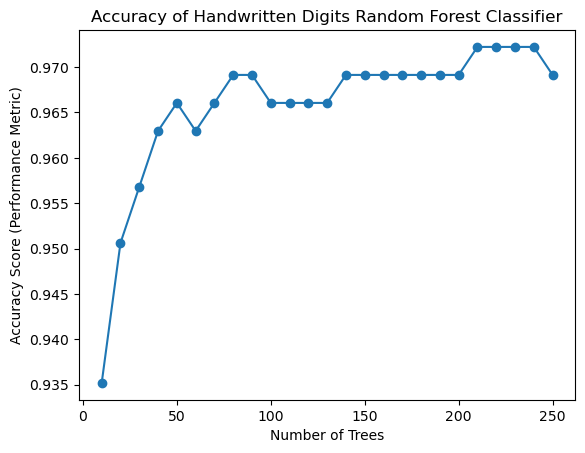

In [28]:
# Plot the relationship
plt.scatter(total_trees, accuracies)
plt.plot(total_trees, accuracies)

plt.xlabel("Number of Trees")
plt.ylabel("Accuracy Score (Performance Metric)")
plt.title("Accuracy of Handwritten Digits Random Forest Classifier")
plt.show()

From the plot above, we can see that increasing the number of trees significantly increases the accuracy score of the Random Forest Classifier from about 0.935 to about 0.975. However, there is a saturation point and after a certain number of trees (200 here), the accuracy score stays the same evenm then decreases. In summary, the n_estimators hyper-parameter should be tuned to increase the performance of your ML model, but care should be taken to not increase it too much since after a certain point the process will become computationally expensive and often lead to overfitting of data at best or yield a negligible increase in performance at best (as determined by accuracy score metric here).

## 3.7 Present solution

## Question 15
(4 pts)

Using the testing data that you left out in the beginning, compute your final performance metrics. Also plot the final confusion matrix. Discuss where your model is good and where the model can still be improved. 

In [29]:
# Use validation data
validate_acc = randForClf(X_train, X_validate, y_train, y_validate, 10)
print("Accuracy of validation set is:", validate_acc)

y_validate_pred = clf_digits.predict(X_validate)
recall_s = recall_score(y_validate, y_validate_pred, average='macro')
print("Recall score of validation set is:", recall_s)

Accuracy of validation set is: 0.9722222222222222
Recall score of validation set is: 0.9778637123745819


[[15  0  0  0  0  0  0  0  0  0]
 [ 0 13  0  0  0  0  0  0  0  0]
 [ 0  0 19  0  0  0  0  0  0  0]
 [ 0  0  0 15  0  0  0  0  0  0]
 [ 0  0  0  0 22  0  0  1  0  0]
 [ 0  0  0  0  0 12  0  0  0  0]
 [ 0  0  0  0  0  0 20  0  0  0]
 [ 0  0  0  0  0  0  0 15  1  0]
 [ 0  1  1  0  0  1  0  0 23  0]
 [ 0  0  0  0  0  0  0  0  0 21]]


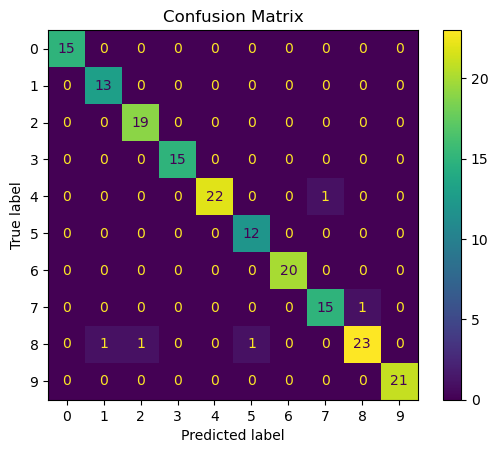

In [30]:
# Plot final confusion matrix
conf_mat = confusion_matrix(y_validate, y_validate_pred)
print(conf_mat)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_mat, display_labels=clf_digits.classes_)
disp.plot()
plt.title('Confusion Matrix')
plt.show()

This model is quite accurate at classifying the handwritten digits. However, the performance could be optimized further by tuning the hyper-parameters besides n_estimator such as max_depth and max_leaf_nodes. In addition, buy using the information entropy criterion instead of the Gini index, there should be a mariginal increase in accuracy of the classifier as demonstrated above.

## 3.8. Launch, Monitor and Maintain

Nothing to here for this lab. 

# Part D - Machine Learning in Particle Physics


## D1 - The Big Picture 

In this part, you will build a random forest machine learning model to recognize types creating of top-quarks in a particle accelarator based on the observed products. We can use the decay products, energy, and momentum vectors to infer the presense of top-quarks. Beyond Standard Model Particle physics models often predict new types of particles so knowing whether the number of top-quarks (which have very high energy compared to other quarks) are as expected can be important for identifying when the Standard Model breaks down. 

Before you begin this experiment, read more about the dataset in Chapter 4, Section 4.1 of the Machine Learning for Physics and Astronomy in the PDF in the lab directory (also on Bruinlearn). 



## D2 - Get the Data

The dataset is included here in `ParticleID_features.csv`, the target is in `'ParticleID_labels.txt`. Our goal is to differentiate between the `4-top` events (interactions of 4 top quark) from the `ttbar` events (interaction of top and anti-top quarks background events). 

In [31]:
# get the data
import pandas as pd
features = pd.read_csv('ParticleID_features.csv')
targets = pd.read_csv('ParticleID_labels.txt',header=None)

## D3 - Explore the data

In this lab, you have the freedom to decide what features you would like to use to train your model and how to clean and inpute your data. 

To help guide you, be sure to answer the following questions about the data. Read Chapter 4, Section 4.1 and 4.3 of the included PDF to learn more and get ideas of how to deal with cleaning the data and selecting good features to use. This chapter also has helpful pandas and sklearn code that will help make some of these tasks easier. Use the ``features.describe()`` to see the statistics of the columns of the ``features`` table. 

## Question 16
(4 pts)

1. What are the columns and what do they mean?
2. Why do some columns have more NaN's than others? 
3. Examine your target classes. What is the distribution of the number of training samples for the two classes? 
4. Make plots to explore some of the features that you are interested in using. 



In [32]:
features

,ID,MET,METphi,Type_1,P1,P2,P3,P4,Type_2,P5,...,Type_12,P45,P46,P47,P48,Type_13,P49,P50,P51,P52
0,0,62803.5,-1.810010,j,137571.0,128444.0,-0.345744,-0.307112,j,174209.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,57594.2,-0.509253,j,161529.0,80458.3,-1.318010,1.402050,j,291490.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,82313.3,1.686840,b,167130.0,113078.0,0.937258,-2.068680,j,102423.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,30610.8,2.617120,j,112267.0,61383.9,-1.211050,-1.457800,b,40647.8,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,45153.1,-2.241350,j,178174.0,100164.0,1.166880,-0.018721,j,92351.3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4995,4995,269074.0,-1.274730,j,495577.0,362590.0,-0.791914,1.671250,b,328278.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4996,4996,12385.8,0.986871,j,258932.0,133559.0,-1.276540,2.970100,j,87822.2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4997,4997,32762.8,3.057630,b,122222.0,79947.8,0.983920,-0.399231,j,260623.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4998,4998,104474.0,-1.875250,b,791028.0,457589.0,1.141530,2.934810,b,304661.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [33]:
features.describe()

,ID,MET,METphi,P1,P2,P3,P4,P5,P6,P7,...,P43,P44,P45,P46,P47,P48,P49,P50,P51,P52
count,5000.000000,5000.000000,5000.000000,5.000000e+03,5.000000e+03,5000.000000,5000.000000,4.997000e+03,4.997000e+03,4997.000000,...,261.000000,261.000000,1.270000e+02,127.000000,127.000000,127.000000,5.600000e+01,56.000000,56.000000,56.000000
mean,2499.500000,64071.074332,-0.028916,3.301357e+05,1.540486e+05,-0.039812,-0.003049,2.527799e+05,1.080302e+05,-0.029936,...,0.029455,0.026422,1.631051e+05,34876.849606,0.206978,-0.001085,1.456600e+05,36151.183929,-0.000879,0.219260
std,1443.520003,60525.122480,1.819257,3.068202e+05,1.149469e+05,1.361762,1.814855,2.638580e+05,8.136261e+04,1.439105,...,1.884750,1.753017,2.248603e+05,20433.767238,1.998859,1.949004,1.943657e+05,25861.883410,1.941707,1.910400
min,0.000000,290.756000,-3.141010,3.857940e+04,2.825400e+04,-4.110220,-3.140710,1.087540e+04,1.080000e+04,-4.668790,...,-4.400470,-3.130690,1.780380e+04,12987.900000,-4.447660,-3.139820,2.512510e+04,14836.000000,-4.448760,-2.990730
25%,1249.750000,24352.375000,-1.619905,1.369522e+05,8.883690e+04,-1.035570,-1.574213,1.007510e+05,6.321840e+04,-1.060500,...,-1.413650,-1.270700,4.365005e+04,24742.500000,-1.259230,-1.817600,4.112588e+04,24974.125000,-1.243362,-1.490900
50%,2499.500000,46814.400000,-0.055612,2.263525e+05,1.182015e+05,-0.038731,-0.009037,1.659740e+05,8.584360e+04,-0.057428,...,-0.088908,-0.041002,8.050910e+04,28262.800000,0.120301,-0.232455,9.553645e+04,27353.550000,-0.121213,0.128103
75%,3749.250000,83032.350000,1.537323,4.077158e+05,1.771265e+05,0.943598,1.542370,2.999950e+05,1.238700e+05,1.028340,...,1.416310,1.514030,1.578350e+05,35445.700000,1.727295,1.712720,1.754910e+05,33817.950000,1.800682,1.984745
max,4999.000000,692674.000000,3.141130,3.186360e+06,1.276710e+06,4.141410,3.138540,3.587700e+06,1.146330e+06,4.559150,...,4.790720,3.120760,1.246080e+06,167840.000000,4.691500,3.091510,1.177730e+06,155888.000000,4.151320,3.058890


In [34]:
targets

,0
0,ttbar
1,ttbar
2,ttbar
3,ttbar
4,ttbar
...,...
4995,4top
4996,ttbar
4997,ttbar
4998,4top


1. There are 67 columns in the features section of the data. The first column represents the magnitude of the MET and the second columns shows the azimuthal component of the MET. The remaining 65 columns can contain up to 13 types of particles from a reaction along with their 4-vector which contains the energy, transverse component of momentum, theta, and phi angles. Each component of the 4-vector has its own column while the particles types themselves have their own column. The targets column of the data have 2 classifiers ttbar and 4top meant to denote the type of event produced by each row of simulated data.
   
2. As we go across the columns in the table (L -> R), we see an increase in NaN values in each column. This could be because not all reactions from the collisions produce a large number of particles. For example, the decay of the top quark only emits 3 particles that are captured by the detector in our simulated data set. There could be many other reactions where a varying number of particles are produced, hence explaining the large amount of NaN values in the later columns.

In [35]:
# 3. Find distribution of the classes in training sample
from sklearn.preprocessing import LabelEncoder

# Labels 4top as 0 and ttbar as 1
targs = LabelEncoder().fit_transform(targets.values)

# Gonna switch it to 4top = 1 and ttbar = 0 cause duh
targs -= 1
targs = np.where(targs==0, targs, 1)

num_4tops = np.sum(targs)/len(targs)
print("The distribution of 4top events in this data set is:", num_4tops)

The distribution of 4top events in this data set is: 0.1622


/opt/conda/lib/python3.11/site-packages/sklearn/preprocessing/_label.py:114: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


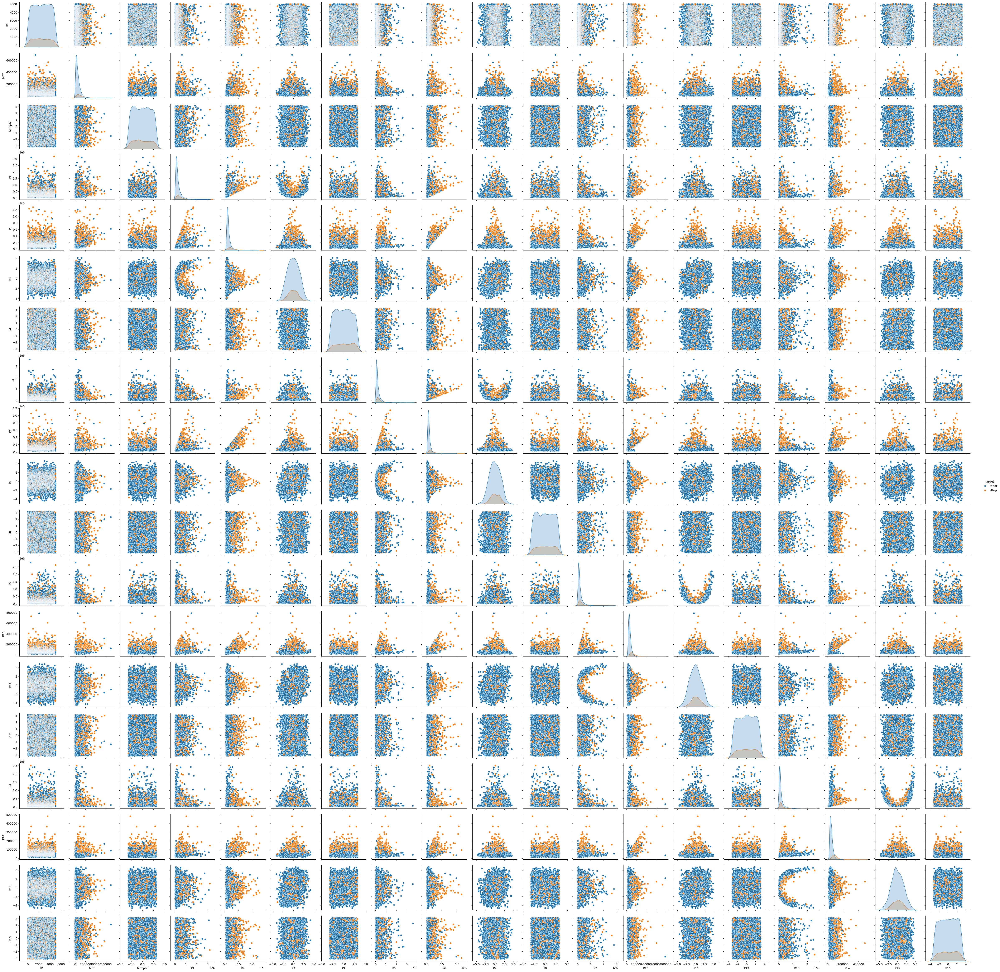

In [36]:
# 4. Make plots, I will do pairplots to visualize the relations between the MET, METphi, and the first 4 particles along with their 4-vectors
# The reasoning behind this will become clear in later steps
import seaborn as sns

plot_features = features.iloc[:,:23]
full_data = pd.concat([plot_features, targets], axis=1)
full_data.columns.values[-1] = 'target'
sns.pairplot(full_data, hue='target')

## D4 - Prepare the Data

Here, you'll be selecting the features and creating your training, testing, and validating data. Again, Chapter 4, Section 4.1 and 4.3 will be helpful for this. 

## Question 17
(6 pts)

1. Choose at least 5 features to use in your random forest model and justfy why you think these are helpful features.
2. Do you need to clean these features? Are there invalid or missing values that you need to deal with? If so describe your method for dealing with them. 
3. Split your dataset into training, testing, and validation. You are free to choose what fraction you would like to use for each. 


1. The features I will use in the random forest model are: MET, METphi, P1, P2, P3, P4, P5, P6, P7, P8, P9, P10, P11, P12, P13, P4, P15, P16. There are 2 main reasons for this. One is that the top quark decays into 3 particles, so we need to look at the first 3 particles if not more. This is why I chose to observe the 4-vectors of the first 4 particles which encode all the necessary information. This leads into the second reason as to why I chose only the first 4 and not more. The MET, METphi, and P1-P16 have only 283 missing values (around 5% of the dataset), this was taken from section 4.3.2 of the Viviana Acquaviva reading. As mentioned before, the number of NaN values significanly increases as we go across the columns since less particles tend to be produced. While there are many ways to deal with NaN values in theses columns, in cases where they are mostly empty filling them in with a lack of good data would be done in an unscientific manner and would not be reliable data to train our model with.

In [37]:
# 2. Dealing with invalid/missing data from the features we chose to keep
particle_features = features[["MET", "METphi", "P1", "P2", "P3", "P4", "P5", "P6", "P7", "P8", 
                              "P9", "P10", "P11", "P12", "P13", "P14", "P15", "P16"]]

# After plotting histograms of each feature, I believe there is no need to clean features
# There are 283 missing values, which we will deal with by making them 0 as a convenient fix
particle_features = particle_features.fillna(0)
particle_features = np.array(particle_features)

# 3. Split data into training, validation, and testing
X_train_all, X_validate, y_train_all, y_validate = model_selection.train_test_split(particle_features, targs, test_size=0.1)

# Split the training data further into training and testing
X_train, X_test, y_train, y_test = model_selection.train_test_split(X_train_all, y_train_all, test_size=0.2)

## D5 - Select model and train

## Question 18
(3 pts)

Use a random forest classifier to train a model to classify `4-top` and ``ttbar`` events. 

In [38]:
event_clf = RandomForestClassifier(random_state=0)

# Train classifier
event_clf.fit(X_train, y_train)

RandomForestClassifier(random_state=0)

## Performance and evaluation metrics


## Question 19
(6 pts)

- First, compute the accuracy score of your random forest classifier. Based on the ratio of ``4-top`` samples compared to the ``ttbar`` class, what accuracy would you expect if you always guess ``ttbar``?
- Use ``sklearn.metrics.classification_report`` to compute some other common metrics. Descibe what each metric means. 
- Compute the confusion matrix and plot it.

In [39]:
# 1. Compute accuracy score
y_pred = event_clf.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
print("Accuracy score of event classifier is:", accuracy)

print("If we always guess ttbar, the accuracy would be:", 1-num_4tops)

rand_guess = np.square(num_4tops) + np.square(1-num_4tops)
print("Guessing randomly would yield an accuracy of:", rand_guess)

Accuracy score of event classifier is: 0.9133333333333333
If we always guess ttbar, the accuracy would be: 0.8378
Guessing randomly would yield an accuracy of: 0.72821768


In [40]:
# 2. Other metrics
from sklearn.metrics import classification_report

report = classification_report(y_test, y_pred)
print(report)

              precision    recall  f1-score   support

           0       0.94      0.96      0.95       764
           1       0.75      0.64      0.69       136

    accuracy                           0.91       900
   macro avg       0.84      0.80      0.82       900
weighted avg       0.91      0.91      0.91       900



There are 4 metrics given here: precision, recall, f1-score, and support.
1. Precision Score: This metric is defined as the ratio of number of true positives to the sum of number of true positives and false positives. The best value is 1 and the worst value is 0. This measures how good the classifier is at avoiding false positive events.
2. Recall Score: This metric is defined as the ratio of number of true positives to the sum of number of true positives and false negatives. The best value is 1 and the worst value is 0. This measures how good the classifier is at finding all positive events.
3. F1-Score: This metric is the harmonic mean of the precison and recall with each of them weighted equally in contribution. The best value is 1 and the worst value is 0. It is useful here since there are far more ttbar events than 4top.
4. The support is the number of occurrences of each class in the test data (y_true).
5. Macro average averages across the unweighted mean for each label.
6. Weighted average averages across the suppoer-weighted mean for each label.

Reference: https://scikit-learn.org/stable/modules/generated/sklearn.metrics.classification_report.html

[[735  29]
 [ 49  87]]


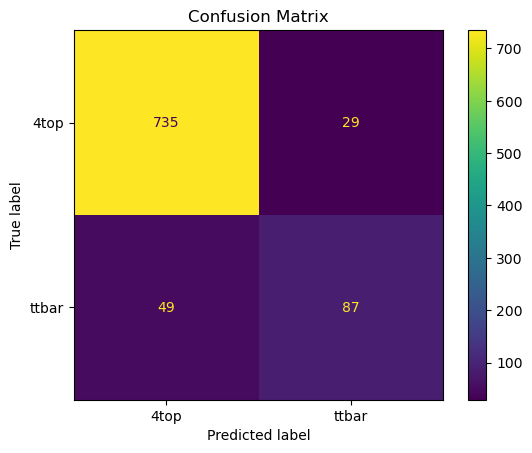

In [41]:
# 3. Compute confusion matrix and plot it
cmat = confusion_matrix(y_test, y_pred)
print(cmat)

display = ConfusionMatrixDisplay(confusion_matrix=cmat, display_labels=['4top', 'ttbar'])
display.plot()
plt.title('Confusion Matrix')
plt.show()

## D6 - Fine tune your model

## Question 20
(6 pts)

Re-run your random forest classifier with other choices for hyper-parameters. Are there better choies of hyper-parameters? Describe your final model and justify your choices. 

In [42]:
# In the initial model, I used fillna(0) as a reference but there are better ways to deal with missing values
# However, it would be better to use a statistical measure to fill in the missing values in the 4-vector columns
# I will use the median from the training split
medians = []

for i in range(X_train.shape[1]): # 18
    this_col = X_train[:,i]
    this_col_median = np.nanmedian(this_col)
    this_col = np.nan_to_num(this_col, nan=this_col_median)
    medians.append(this_col_median)

# Fill in test and validation data with same median values
for i in range(X_test.shape[1]): # 18
    this_col = X_test[:,i]
    this_col = np.nan_to_num(this_col, nan=medians[i])

for i in range(X_validate.shape[1]): # 18
    this_col = X_validate[:,i]
    this_col = np.nan_to_num(this_col, nan=medians[i])

In [43]:
# Grid search to find optimal combination of hyperparameters
from sklearn.model_selection import GridSearchCV

params_set = {
    'n_estimators': [50, 80, 100, 120],
    'max_depth': [1, 5, 10, 20],
    'min_samples_leaf': [1, 2, 4]
}

find_optimal_params = GridSearchCV(estimator=event_clf, param_grid=params_set, cv=5, scoring='accuracy')
find_optimal_params.fit(X_train, y_train)

best_params = find_optimal_params.best_params_
print("Optimal set of parameters:", best_params)

best_acc = find_optimal_params.best_score_
print("Best accuracy score:", best_acc)

optim_model = find_optimal_params.best_estimator_
print("Best model:", optim_model)

test_set_accuracy = optim_model.score(X_test, y_test)
print("Accuracy on test set:", test_set_accuracy)

Optimal set of parameters: {'max_depth': 10, 'min_samples_leaf': 4, 'n_estimators': 50}
Best accuracy score: 0.8988888888888888
Best model: RandomForestClassifier(max_depth=10, min_samples_leaf=4, n_estimators=50,
                       random_state=0)
Accuracy on test set: 0.9155555555555556


For the final model, I changed how my data set handles NaN values. By replacing the missing values with the median value in their column instead of 0, the data will be more reflective of the actual values and will allow our model to learn better. On average, there is a marginal increase in the accuracy score by about 1%. In addition to this, we want to find the optimal set of hyper-parameters to improve the performance of the Random Forest Classifier model. An efficient way of doing this is by using a grid search which will calculate the accuracy (performance metric used here) of each model with different parameters and find the best combination. Thus, we know tha values chosen from the parameter grid are the best thus making this the best final model. A more rigorous gride could be made with larger sets of values, however the compuatation would signficantly increase making this method less feasible.

## D7 - Present your solution


## Question 21
(6 pts)

Describe the performance of your model on the validation data set. Describe two improvements that one could make in this work in the future (for example how to improve: data collection, feature engineering, data cleaning, model buiding, etc.). 

In [44]:
validation_set_accuracy = optim_model.score(X_validate, y_validate)
print("Accuracy on validation set:", validation_set_accuracy)

Accuracy on validation set: 0.894


In [45]:
# Get the classification report
y_pred_validate = find_optimal_params.best_estimator_.predict(X_validate)

final_report = classification_report(y_validate, y_pred_validate)
print(final_report)

              precision    recall  f1-score   support

           0       0.91      0.97      0.94       414
           1       0.78      0.53      0.63        86

    accuracy                           0.89       500
   macro avg       0.84      0.75      0.79       500
weighted avg       0.89      0.89      0.89       500



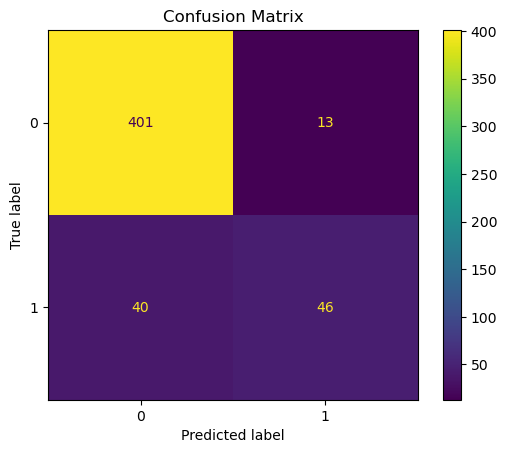

In [46]:
# Plot a confusion matrix for good measure (literally...)
final_cm = confusion_matrix(y_validate, y_pred_validate)
final_display = ConfusionMatrixDisplay(final_cm)
final_display.plot()
plt.title('Confusion Matrix')
plt.show()

2 improvements that could be made to this model are:
1. Feature Engineering: By searching for correlation between different features in the data, this should lead to an overall increase in the performance of the classifier. Intially, we chose features based on them having less missing values but feature engineering could imporve out selection by finding relevant features to train our model on.
2. Data Cleaning: Instead of replacing the missing values with the median values in the column, it might be better to find another statistical measure or regression technique to fill in these values. Such a technique would also allow our model to use columns with more missing values, giving the model more data to train on and improving its overall performance.

# Submit your lab

You're done! Congrats!